# Worksheet 07

Name: William Seong
UID: U76365580

### Topics

- Density-Based Clustering

### Density-Based Clustering

Follow along with the live coding of the DBScan algorithm.

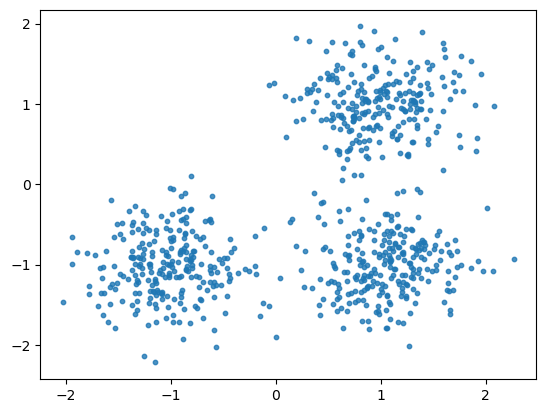

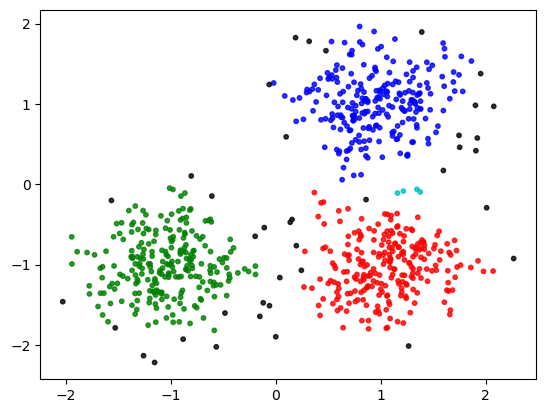

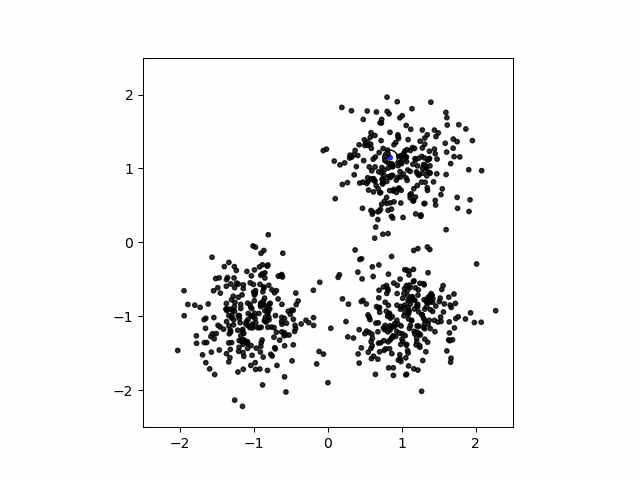

In [14]:
import numpy as np
import matplotlib.pyplot as plt
import sklearn.datasets as datasets
from PIL import Image as im
import io
from IPython.display import Image

centers = [[1, 1], [-1, -1], [1, -1]]
X, _ = datasets.make_blobs(n_samples=750, centers=centers, cluster_std=0.4, random_state=0)
plt.scatter(X[:,0],X[:,1],s=10, alpha=0.8)
plt.show()

colors = np.array([x for x in 'bgrcmykbgrcmykbgrcmykbgrcmyk']) # create a list of strings, assuming it's a bunch of colors
colors = np.hstack([colors] * 20) # make it longer in case we got a bunch of clusters

class DBC():

    def __init__(self, dataset, min_pts, epsilon):
        self.dataset = dataset
        self.min_pts = min_pts
        self.epsilon = epsilon
        self.assignments = [-1 for _ in range(len(self.dataset))]
        self.image = 0
        self.snaps = []
        
    def is_unassigned(self, i):
        return self.assignments[i] == -1
    
    def distance(self, i, j):
        return np.linalg.norm(self.dataset[i] - self.dataset[j])
        
    def get_neighborhood(self, i):
        neighborhood = []
        for j in range(len(self.dataset)):
            if i != j and self.distance(i, j) <= self.epsilon:
                neighborhood += [j]
        return neighborhood
    
    def get_unassigned_neighborhood(self, i):
        neighborhood = self.get_neighborhood(i)
        return [point for point in neighborhood if self.is_unassigned(point)]
        
    def is_core(self, i):
        return len(self.get_neighborhood(i)) >= self.min_pts
    
    def make_cluster(self, i, cluster_num):
        self.assignments[i] = cluster_num
        self.snapshot(i)

        neighborhood_queue = self.get_unassigned_neighborhood(i)
        
        while neighborhood_queue:
            next_pt = neighborhood_queue.pop()
            
            if not self.is_unassigned(next_pt):
                continue
                
            self.assignments[next_pt] = cluster_num
            self.snapshot(next_pt)

            
            if self.is_core(next_pt):
                neighborhood_queue += self.get_unassigned_neighborhood(next_pt)
        
        return
    
    def snapshot(self, i):
#         print("Taking snapshot", self.image)
        
        fig, ax = plt.subplots()
        
        ax.scatter(X[:, 0], X[:, 1], color=colors[self.assignments].tolist(), s=10, alpha=0.8)        
        
        coordinate = self.dataset[i]
        
        cir = plt.Circle((coordinate[0],coordinate[1]), radius = .1, fill = False)
        ax.add_patch(cir)
        ax.set_aspect('equal')
        ax.set_xlim(-2.5,2.5)
        ax.set_ylim(-2.5,2.5)
        
        ax.set_xticks(np.arange(-2, 3, 1))
        ax.set_yticks(np.arange(-2, 3, 1))
        
        buf = io.BytesIO()
        plt.savefig(buf, format='png')
        buf.seek(0)
        
        img = im.open(buf)
        
        self.image += 1
        self.snaps.append(img)  
        plt.close()

    def dbscan(self):
        """
        returns a list of assignments. The index of the
        assignment should match the index of the data point
        in the dataset.
        """
        
        cluster_num = 0
                
        for i in range(len(self.dataset)):
            if self.assignments[i] != -1:
                continue
                
            if self.is_core(i):
                # start building a new cluster
                self.make_cluster(i, cluster_num)
                cluster_num += 1
        return self.assignments

dbc = DBC(X, 3, .2)
clustering = dbc.dbscan()

plt.scatter(X[:, 0], X[:, 1], color=colors[clustering].tolist(), s=10, alpha=0.8)        
plt.show()

dbc.snaps[0].save(
    'test.gif',
    optimize=False,
    save_all=True,
    append_images=dbc.snaps[1:],
    loop=0,
    duration=75
)
Image(filename="test.gif", width=800, height=500)


## Challenge Problem

Using the code above and the template provided below, create the animation below of the DBScan algorithm.

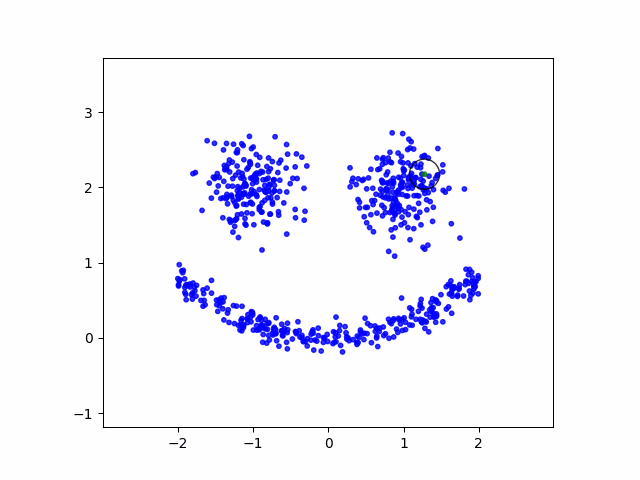

In [2]:
from IPython.display import Image
Image(filename="dbscan_2.gif", width=500, height=500)

Hints:

- First animate the dbscan algorithm for the dataset used in class (before trying to create the above dataset)
- Take a snapshot of the assignments when the point gets assigned to a cluster
- Confirm that the snapshot works by saving it to a file
- Don't forget to close the matplotlib plot after saving the figure
- Gather the snapshots in a list of images that you can then save as a gif using the code below
- Use `ax.set_aspect('equal')` so that the circles don't appear to be oval shaped
- To create the above dataset you need two blobs for the eyes. For the mouth you can use the following process to generate (x, y) pairs:
  - Pick an x at random in an interval that makes sense given where the eyes are positioned
  - For that x generate y that is 0.2 * x^2 plus a small amount of randomness
  - `zip` the x's and y's together and append them to the dataset containing the blobs

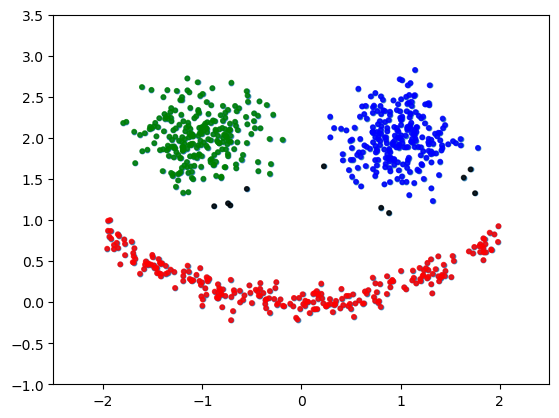

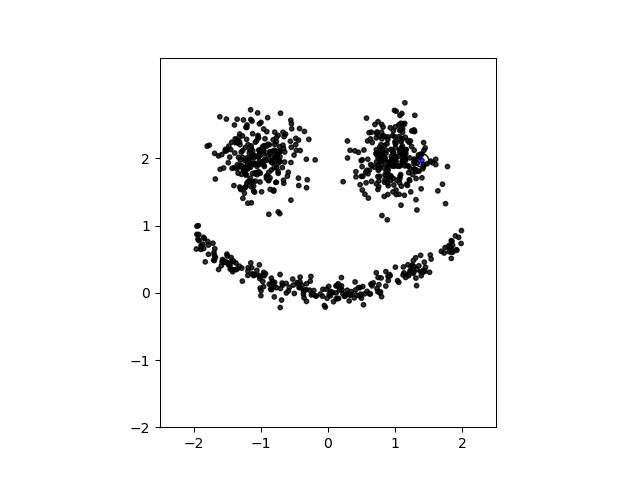

In [13]:
import numpy as np
import matplotlib.pyplot as plt
import sklearn.datasets as datasets
from PIL import Image as im
import io
from IPython.display import Image

centers = [[-1, 2], [1, 2]] # Create initial centers
eyes, _ = datasets.make_blobs(n_samples=500, centers=centers, cluster_std = 0.3, random_state = 0)

face = eyes

for x in range(250):
    mouth_x = 2 * np.random.uniform(-1.0, 1.0)
    mouth_y = .2 * (mouth_x ** 2) + .1 * np.random.randn()
    mouth = [mouth_x] + [mouth_y]
    face = np.append(face, [mouth], axis=0)

fig, ax = plt.subplots()
ax.scatter(face[:,0],face[:,1],s=10, alpha=0.8)
ax.set_xlim(-2.5,2.5)
ax.set_ylim(-1,3.5)

colors = np.array([x for x in 'bgrcmykbgrcmykbgrcmykbgrcmyk'])
colors = np.hstack([colors] * 20)

class DBC():

    def __init__(self, dataset, min_pts, epsilon):
        self.dataset = dataset
        self.min_pts = min_pts
        self.epsilon = epsilon
        self.assignments = [-1 for _ in range(len(self.dataset))]
        self.image = 0
        self.snaps = []

    def is_unassigned(self, i):
        return self.assignments[i] == -1

    def distance(self, i, j):
        return np.linalg.norm(self.dataset[i] - self.dataset[j])

    def get_neighborhood(self, i):
        neighborhood = []
        for j in range(len(self.dataset)):
            if i != j and self.distance(i, j) <= self.epsilon:
                neighborhood += [j]
        return neighborhood

    def get_unassigned_neighborhood(self, i):
        neighborhood = self.get_neighborhood(i)
        return [point for point in neighborhood if self.is_unassigned(point)]

    def is_core(self, i):
        return len(self.get_neighborhood(i)) >= self.min_pts

    def make_cluster(self, i, cluster_num):
        self.assignments[i] = cluster_num

        self.snapshot(i)

        neighborhood_queue = self.get_unassigned_neighborhood(i)

        while neighborhood_queue:
            next_pt = neighborhood_queue.pop()

            if not self.is_unassigned(next_pt):
                continue

            self.assignments[next_pt] = cluster_num
            #snapshot here
            self.snapshot(next_pt)

            if self.is_core(next_pt):
                neighborhood_queue += self.get_unassigned_neighborhood(next_pt)
        return

    def snapshot(self, i):

        fig, ax = plt.subplots()

        ax.scatter(face[:, 0], face[:, 1], color=colors[self.assignments].tolist(), s=10, alpha=0.8)

        coordinate = self.dataset[i]

        cir = plt.Circle((coordinate[0],coordinate[1]), radius = .1, fill = False) # create circle around the point assigned
        ax.add_patch(cir)
        ax.set_aspect('equal')
        ax.set_xlim(-2.5,2.5)
        ax.set_ylim(-1,3.5)

        ax.set_xticks(np.arange(-2, 3, 1))
        ax.set_yticks(np.arange(-2, 3, 1))

        buf = io.BytesIO()
        plt.savefig(buf, format='png')
        buf.seek(0)

        img = im.open(buf)

        self.image += 1
        self.snaps.append(img)
        plt.close()

    def dbscan(self):
        """
        returns a list of assignments. The index of the
        assignment should match the index of the data point
        in the dataset.
        """

        cluster_num = 0

        for i in range(len(self.dataset)):
            if self.assignments[i] != -1:
                continue

            if self.is_core(i):
                # start building a new cluster
                self.make_cluster(i, cluster_num)
                cluster_num += 1
        return self.assignments

dbc = DBC(face, 3, .2)
clustering = dbc.dbscan()
plt.scatter(face[:, 0], face[:, 1], color=colors[clustering].tolist(), s=10, alpha=0.8)
plt.show()

dbc.snaps[0].save(
    'dbscan.gif',
    optimize=False,
    save_all=True,
    append_images=dbc.snaps[1:],
    loop=0,
    duration=25
)
Image(filename="dbscan.gif", width=500, height=500)